In [11]:
ls

 Volume in drive C has no label.
 Volume Serial Number is 1271-A82D

 Directory of C:\Users\FREEDMAN_LAB\Documents\StephT\two_boundary_DMC\MT_analysis

02/04/2020  02:19 PM    <DIR>          .
02/04/2020  02:19 PM    <DIR>          ..
02/04/2020  02:14 PM    <DIR>          .ipynb_checkpoints
01/31/2020  05:03 PM            59,301 category_decoder.ipynb
01/31/2020  05:04 PM            58,292 dir_decoder.ipynb
01/31/2020  02:28 PM            63,765 dir_decoder-Copy1.ipynb
01/29/2020  11:51 AM        85,324,444 neville_20191004_1_merged_w_ratings.mat
01/29/2020  11:53 AM        85,313,586 neville_20191007_2_merged_w_ratings.mat
01/29/2020  11:53 AM        77,382,867 neville_20191015_2_merged_w_ratings.mat
01/29/2020  11:53 AM        63,517,755 neville_20191018_1_merged_w_ratings.mat
01/29/2020  11:53 AM        77,631,602 neville_20191028_1_merged_w_ratings.mat
01/29/2020  11:53 AM        60,659,697 neville_20191030_1_merged_w_ratings.mat
01/29/2020  11:53 AM        90,833,295 neville_2019

In [12]:
import os
import glob
import scipy.io as sio
import numpy as np
import scipy as sci
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
np.set_printoptions(threshold=4000, precision=4) 

# Generate PSTHs
### First, define the function for doing so, given the appropriate data file

In [13]:
def generate_psth(fn):
    
    # Load the file specified by fn
    monkey_name = fn[0:7]
    date        = fn[8:18]
    data        = sio.loadmat(fn)['data']
    
    # Split up neuronal/behavioral
    bhv   = data['BHV']
    neuro = data['NEURO']
    
    # Extract relevant behavioral variables for all the trials
    error     = bhv[0][0][0][0]["TrialError"]
    trial_num = len(bhv[0][0][0][0]["TrialNumber"][0])
    condition = bhv[0][0][0][0]["ConditionNumber"][0]

    # Do the same for neural data
    num_neurons = len(neuro[0][0][0][0]["Neuron"][0][0])//2
    spikes_all  = neuro[0][0][0][0]["Neuron"][0][0]
    code_time   = neuro[0][0][0][0]['CodeTimes']
    code_num    = neuro[0][0][0][0]['CodeNumbers']
    code_num    = np.array([i[0] for i in code_num]) 
    
    # Trial timing parameters
    SAMPLE = 550
    DELAY1 = 1200 + SAMPLE
    TEST1  = 550 + DELAY1
    DELAY2 = 175 + TEST1
    TEST2  = 550 + DELAY2

    # Other trial parameters
    trial_epochs = [SAMPLE, DELAY1, TEST1, DELAY2, TEST2]
    dirs         = [247.5, 225, 202.5, 67.5, 45, 22.5, 157.5, 135, 112.5, 337.5, 315, 292.5]
    STRT_TRIAL   = 9
    STIM_ON      = 23
    
    strt_trial_indx = np.where(code_num == STRT_TRIAL)[0]
    strt_trial_time = code_time[strt_trial_indx]
    spk_window      = np.arange(-500, 3000) 
 

    # Correct trial IDs
    correct_inds   = set(np.where(error == 0)[0])
    condition_inds = set(np.where(condition != 73)[0])
    trial_inds     = correct_inds.intersection(condition_inds)
    
    # Loop through neurons
    for i_neuron in range(num_neurons):
        
        # Set up storage for spikes by direction
        spikes_binned = [[] for i in range(len(dirs))]

        # Extract neural data for this neuron across trials
        neuron_name   = neuro[0][0][0][0][1][0][0].dtype.names[i_neuron]
        rating        = neuro[0][0][0][0][-1][i_neuron][1][0][0]
        neuron_spikes = spikes_all[i_neuron].flatten() 

        # Loop through trials
        for i_trial in trial_inds:
            if code_num[strt_trial_indx[i_trial]+1] != 14:
                end_indx = min(i_trial + 1, trial_num) 
                
                # Compute when the stimulus for this trial came on
                stim_on_indx = np.where(code_num[strt_trial_indx[i_trial]:strt_trial_indx[end_indx]] == STIM_ON)[0]
                stim_on_indx = stim_on_indx + strt_trial_indx[i_trial]

                # Find spike times for this trial based on stim. on index, compute histogram
                stim_on_time = code_time[stim_on_indx].flatten()[0]
                spks         = neuron_spikes[(neuron_spikes - stim_on_time > -500) & (neuron_spikes - stim_on_time < 3000)] - stim_on_time
                hist_spks    = np.histogram(spks, spk_window)[0]

                # Store the histogram for this trial
                dir_num = int(np.ceil(condition[i_trial]/6)) - 1
                spikes_binned[dir_num].append(hist_spks)

        # Take averages by direction
        avg_spikes = [np.array(i).squeeze().mean(axis=0) for i in spikes_binned] 

        # Find max Y (for manual adjustment later)           
        gaussian_filter1d_binned = np.array([gaussian_filter1d(i*1000, 30) for i in avg_spikes])
        maxima_gaussian_filter1d =  np.amax(gaussian_filter1d_binned, axis=1)

        t = np.arange(-500, 3000)    
        fig, ax = plt.subplots(1, figsize=(10, 5))
        for i in range(len(avg_spikes)):
            if i < len(dirs) // 2:
                if i == len(dirs) // 2 - 1:
                    ax.plot(t[0:-1], gaussian_filter1d(avg_spikes[i]*1000, 30), lw=2, color='#16BAC5', label='Category 1')
                else:
                    ax.plot(t[0:-1], gaussian_filter1d(avg_spikes[i]*1000, 30), lw=2, color='#16BAC5')
            else:
                if i == len(dirs) - 1:
                    ax.plot(t[0:-1], gaussian_filter1d(avg_spikes[i]*1000, 30), lw=2, color = '#E02664', label='Category 2')
                else:
                    ax.plot(t[0:-1], gaussian_filter1d(avg_spikes[i]*1000, 30), lw=2, color = '#E02664')

        # Separate task periods
        ax.plot([0, 0], [0, 200], '--k', lw = 1.3)
        for epoch in trial_epochs:
            ax.plot([epoch, epoch], [0, 200], '--k', lw = 1.3)
        
        # Labels, etc.
        ax.legend(title='Category')
        ax.set(xlabel='Time (ms)', 
               ylabel='Firing rate (spks/sec)', 
               title='PSTH: MT neuron {}'.format(neuron_name))
        
        
        # Fit the y-axis better
        max_fr = max(maxima_gaussian_filter1d)
        plt.xlim([t[0], t[-1]])
        plt.ylim([0, max_fr*1.2])
        plt.tight_layout()
        plt.show()
        
        # Save based on rating
        if rating >= 2.9:        
            fname_fig = 'good_neurons/{}_{}_{}.png'.format(monkey_name,date,neuron_name)
            fname_data = 'good_neurons/{}_{}'.format(date, neuron_name)
        else:
            fname_fig = 'bad_neurons/{}_{}_{}.png'.format(monkey_name, 
                                                                                    date, neuron_name)
            fname_data = 'bad_neurons/{}_{}.mat'.format(date, neuron_name)

        if not os.path.exists('good_neurons/'):
            os.makedirs('good_neurons/')
        if not os.path.exists('bad_neurons/'):
            os.makedirs('bad_neurons/')
        fig.savefig(fname_fig, bbox_inches='tight', dpi=500)

        plt.close(fig)

### Now: actually compute the PSTHs, and save appropriately

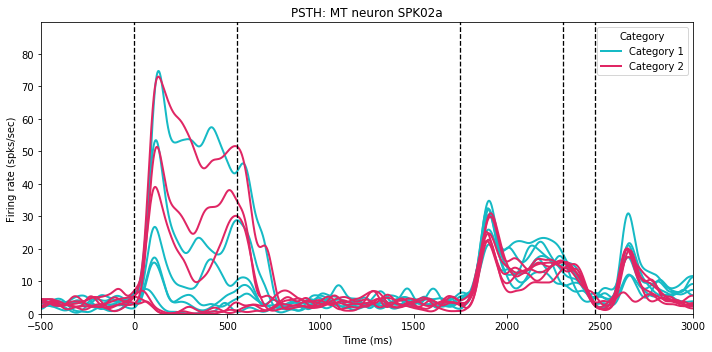

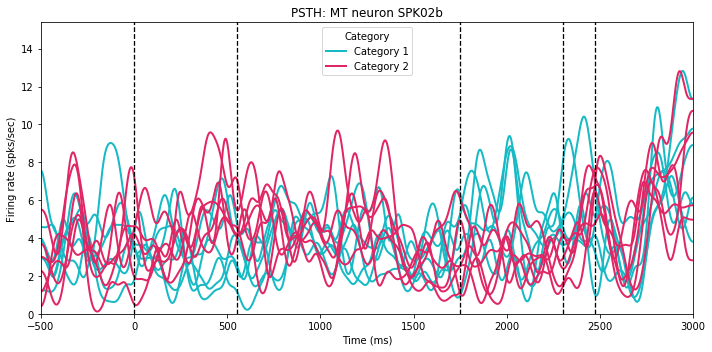

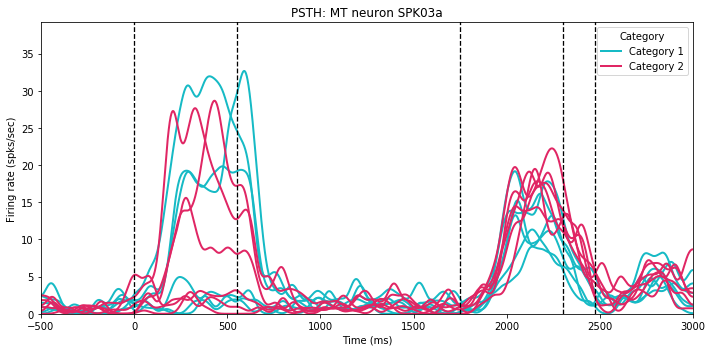

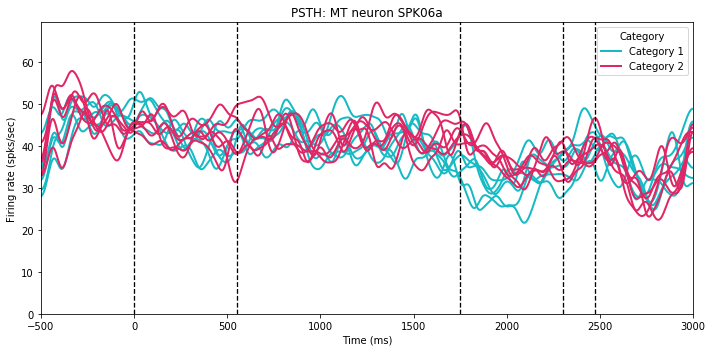

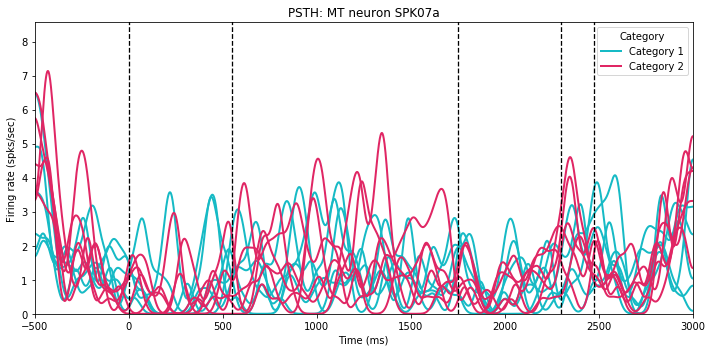

...

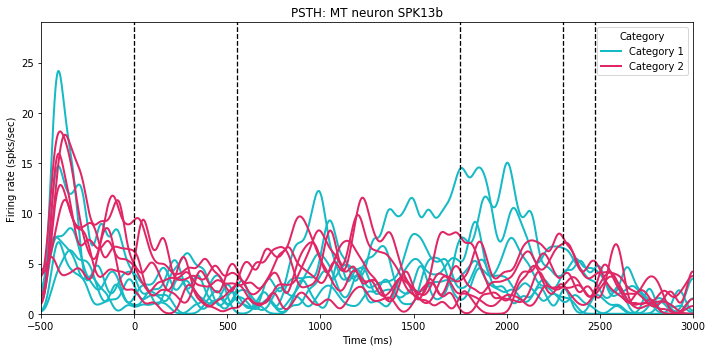

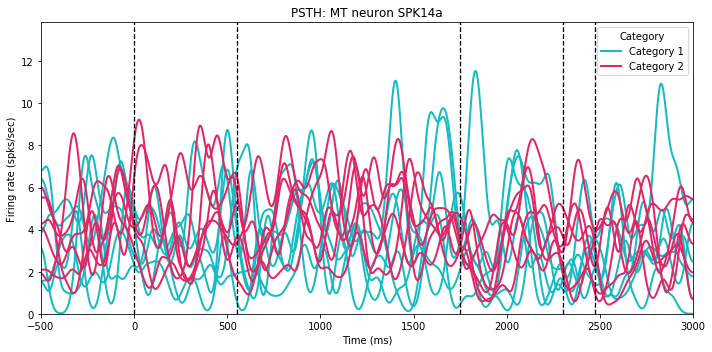

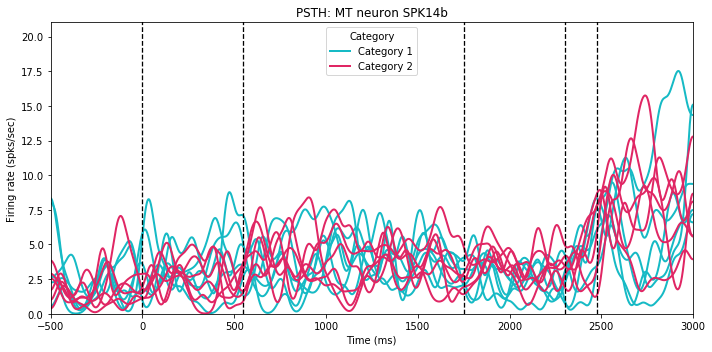

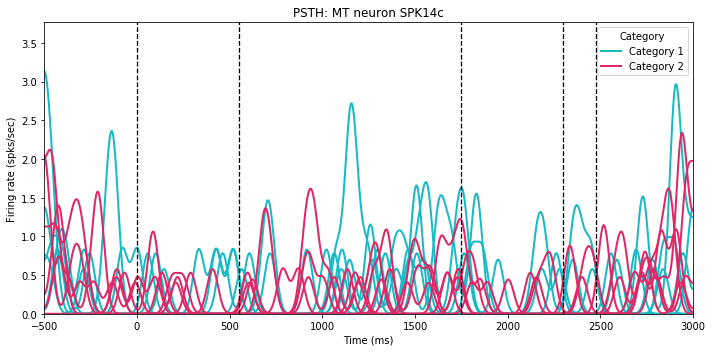

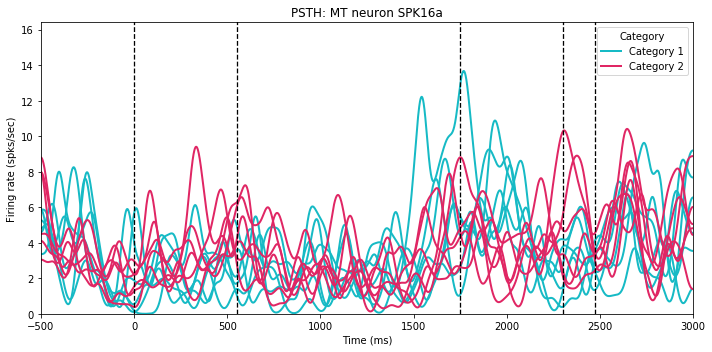

In [14]:
fns = glob.glob("neville_*_merged_w_ratings.mat")
for fn in fns:
    generate_psth(fn)